# does this work?

In [1]:
import sympy as sp
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from scipy.integrate import solve_ivp
from IPython.display import HTML  # For displaying animations inline

# **AE370 Group Project 1: Double Pendulum**
## Aditya Srikanth, Nia Smith, Pratham Puskur

## **Introduction: Why the Double Pendulum Is Relevant in Engineering**

The **double pendulum** is a classic example of a nonlinear, coupled dynamic system that highlights the strength of **Lagrangian mechanics**. While traditional Newtonian analysis requires tracking forces and constraints on each mass individually, Lagrangian mechanics allows us to describe the entire system using **generalized coordinates** — in this case, the angular displacements $ \theta_1 $ and $ \theta_2 $.

### The Lagrangian Approach

The **Lagrangian** of a system is defined as:

$$
L = T - V
$$

where $ T $ is the total kinetic energy and $ V $ is the total potential energy. From this, the equations of motion are derived using the **Euler-Lagrange equations**:

$$
\frac{d}{dt} \left( \frac{\partial L}{\partial \dot{q}_i} \right) - \frac{\partial L}{\partial q_i} = 0
$$

This approach leads to a **system of differential equations** that fully characterizes the motion of the pendulum, even in the presence of nonlinear and coupled dynamics.

### Engineering Relevance

The double pendulum exemplifies many challenges that are common in engineering systems:

- **Nonlinearity**: The equations of motion are nonlinear, which is typical in real-world systems.
- **Coupling**: The motion of one link directly affects the other, just like in robotic arms or mechanical linkages.
- **Chaos**: The system is highly sensitive to initial conditions, making it a useful model in control and stability analysis.

Understanding the dynamics of the double pendulum helps engineers develop intuition and analytical techniques that scale to more complex systems such as:

- Robotic manipulators  
- Aerospace attitude dynamics  
- Suspension systems and structural dynamics

Studying the double pendulum using Lagrangian mechanics not only deepens understanding of physical behavior but also introduces engineers to **energy-based modeling**, **symbolic computation**, and **simulation**, all of which are foundational in modern engineering practice.


In [2]:
# Define symbols and Lagrangian (same as your original code)
t = sp.Symbol('t')
theta1 = sp.Function('theta1')(t)
theta2 = sp.Function('theta2')(t)
theta3 = sp.Function('theta3')(t)
dtheta1 = sp.diff(theta1, t)
dtheta2 = sp.diff(theta2, t)
dtheta3 = sp.diff(theta3, t)

m1, m2, m3, l1, l2, l3, g = sp.symbols('m1 m2 m3 l1 l2 l3 g')

# Positions, velocities, energies, and Lagrangian
x1 = l1 * sp.sin(theta1)
y1 = -l1 * sp.cos(theta1)
x2 = x1 + l2 * sp.sin(theta2)
y2 = y1 - l2 * sp.cos(theta2)
x3 = x2 + l3 * sp.sin(theta3)
y3 = y2 - l3 * sp.cos(theta3)

vx1 = sp.diff(x1, t)
vy1 = sp.diff(y1, t)
vx2 = sp.diff(x2, t)
vy2 = sp.diff(y2, t)
vx3 = sp.diff(x3, t)
vy3 = sp.diff(y3, t)

T1 = (1/2) * m1 * (vx1**2 + vy1**2)
T2 = (1/2) * m2 * (vx2**2 + vy2**2)
T3 = (1/2) * m3 * (vx3**2 + vy3**2)

V1 = m1 * g * y1
V2 = m2 * g * y2
V3 = m3 * g * y3

L = T1 + T2 + T3 - V1 - V2 - V3

# Euler-Lagrange equations
def lagrange_eq(L, q):
    dL_dq = sp.diff(L, q)
    dL_ddq = sp.diff(L, sp.diff(q, t))
    dt_dL_ddq = sp.diff(dL_ddq, t)
    return sp.simplify(dt_dL_ddq - dL_dq)

eom1 = lagrange_eq(L, theta1)
eom2 = lagrange_eq(L, theta2)
eom3 = lagrange_eq(L, theta3)

In [3]:
# Solve for theta1'' and theta2''
solutions = sp.solve(
    [sp.Eq(eom1, 0), sp.Eq(eom2, 0), sp.Eq(eom3, 0)],
    [sp.diff(theta1, t, 2), sp.diff(theta2, t, 2), sp.diff(theta3, t, 2)]
)
theta1_ddot = solutions[sp.diff(theta1, t, 2)]
theta2_ddot = solutions[sp.diff(theta2, t, 2)]
theta3_ddot = solutions[sp.diff(theta3, t, 2)]

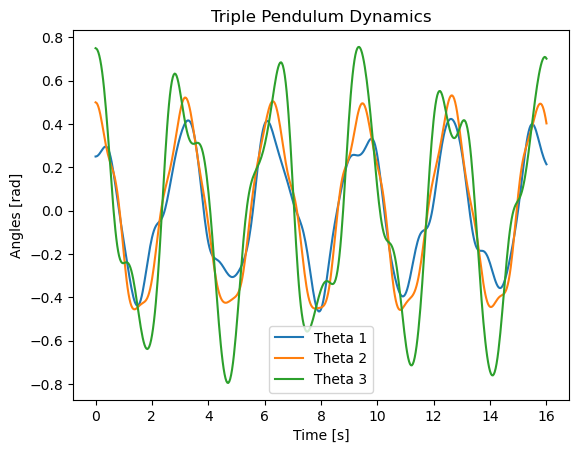

In [4]:
# Lambdify the expressions for numerical evaluation
theta1_ddot_func = sp.lambdify(
    (theta1, theta2, theta3, dtheta1, dtheta2, dtheta3, g, l1, l2, l3, m1, m2, m3),
    theta1_ddot,
    modules='numpy'
)
theta2_ddot_func = sp.lambdify(
    (theta1, theta2, theta3, dtheta1, dtheta2, dtheta3, g, l1, l2, l3, m1, m2, m3),
    theta2_ddot,
    modules='numpy'
)

theta3_ddot_func = sp.lambdify(
    (theta1, theta2, theta3, dtheta1, dtheta2, dtheta3, g, l1, l2, l3, m1, m2, m3),
    theta3_ddot,
    modules='numpy'
)

# ODE function for scipy.integrate.odeint
def triple_pendulum_ivp(t, y, g, l1, l2, l3, m1, m2, m3):
    # Unpack the state vector y
    theta1, theta2, theta3, omega1, omega2, omega3 = y
    
    # Compute the angular accelerations using the lambdified functions
    theta1_ddot = theta1_ddot_func(theta1, theta2, theta3, omega1, omega2, omega3, g, l1, l2, l3, m1, m2, m3)
    theta2_ddot = theta2_ddot_func(theta1, theta2, theta3, omega1, omega2, omega3, g, l1, l2, l3, m1, m2, m3)
    theta3_ddot = theta3_ddot_func(theta1, theta2, theta3, omega1, omega2, omega3, g, l1, l2, l3, m1, m2, m3)
    
    # Return the derivatives of the state variables (dy/dt)
    return [omega1, omega2, omega3, theta1_ddot, theta2_ddot, theta3_ddot]

# Parameters and initial conditions
g_val = 9.81
l1_val, l2_val, l3_val = 1.0, 1.0, 1.0
m1_val, m2_val, m3_val = 1.0, 1.0, 1.0
y0 = y0 = [0.25, 0.5, 0.75, 0.0, 0.0, 0.0]  # Initial conditions
t_span = (0, 16)
t_eval = np.linspace(0, 16, 480)  # Time points

# Call solve_ivp with Radau method
sol = solve_ivp(
    triple_pendulum_ivp,
    t_span,
    y0,
    method='RK45',  # Switch to Radau for better stiffness handling
    t_eval=t_eval,
    args=(g_val, l1_val, l2_val, l3_val, m1_val, m2_val, m3_val)
)

# Access results
theta1_vals = sol.y[0]
theta2_vals = sol.y[1]
theta3_vals = sol.y[2]

import matplotlib.pyplot as plt
plt.plot(t_eval, theta1_vals, label='Theta 1')
plt.plot(t_eval, theta2_vals, label='Theta 2')
plt.plot(t_eval, theta3_vals, label='Theta 3')
plt.legend()
plt.xlabel('Time [s]')
plt.ylabel('Angles [rad]')
plt.title('Triple Pendulum Dynamics')
plt.show()

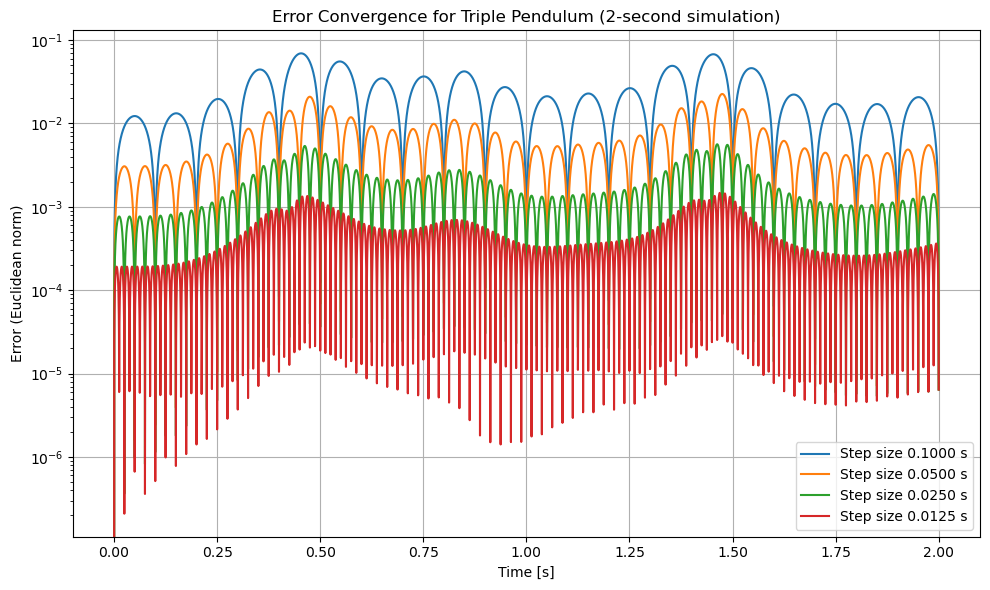

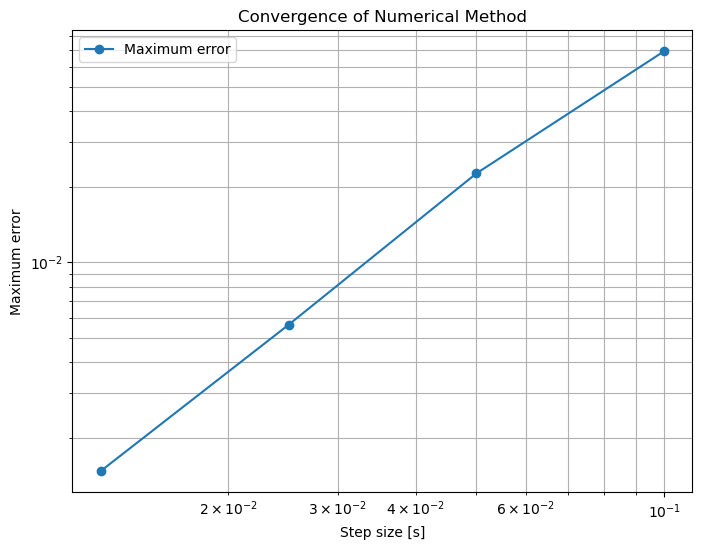

Convergence rates between steps: [1.61886211 2.00426661 1.93659823]
Average convergence rate: 1.8683


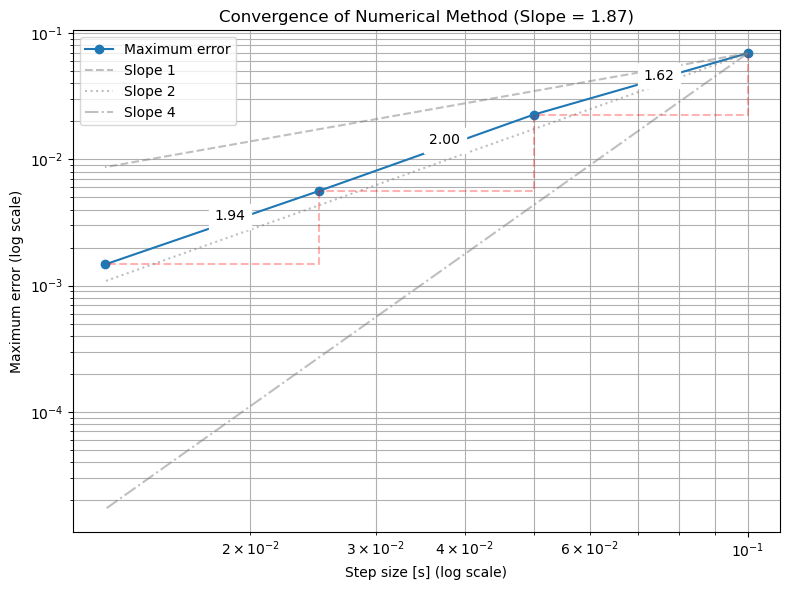

In [18]:
import numpy as np
from scipy.integrate import solve_ivp
from scipy.interpolate import interp1d
import matplotlib.pyplot as plt

# Function to compute error (improved version)
def compute_error(reference_solution, coarse_solution, t_eval_reference, t_eval_coarse):
    # Interpolate the coarse solution to the reference time points
    interp_coarse = interp1d(t_eval_coarse, coarse_solution, axis=0, kind='linear', bounds_error=False, fill_value="extrapolate")
    
    # Compute the error (Euclidean norm of the difference)
    error = np.linalg.norm(reference_solution - interp_coarse(t_eval_reference), axis=1)
    
    return error

# Parameters for the triple pendulum
g_val = 9.81
l1_val, l2_val, l3_val = 1.0, 1.0, 1.0
m1_val, m2_val, m3_val = 1.0, 1.0, 1.0
y0 = np.array([np.pi/2, 0, 0, 0, 0, 0])  # Initial conditions
t_span = (0, 2)  # 2-second simulation

# Create a very fine reference solution
t_eval_reference = np.linspace(0, 2, 10000)  # Very fine grid for reference
sol_reference = solve_ivp(
    triple_pendulum_ivp,
    t_span,
    y0,
    method='RK45',
    t_eval=t_eval_reference,
    args=(g_val, l1_val, l2_val, l3_val, m1_val, m2_val, m3_val),
    rtol=1e-10,
    atol=1e-10
)

# Extract reference solution (angles only)
theta1_vals_reference = sol_reference.y[0]
theta2_vals_reference = sol_reference.y[1]
theta3_vals_reference = sol_reference.y[2]
reference_solution = np.vstack([theta1_vals_reference, theta2_vals_reference, theta3_vals_reference]).T

# Test different step sizes
step_sizes = [0.1, 0.05, 0.025, 0.0125]  # Coarser step sizes
errors = []

for step_size in step_sizes:
    # Number of points based on step size
    num_points = int((t_span[1] - t_span[0]) / step_size) + 1
    t_eval_coarse = np.linspace(t_span[0], t_span[1], num_points)
    
    # Solve with current step size
    sol_coarse = solve_ivp(
        triple_pendulum_ivp,
        t_span,
        y0,
        method='RK45',
        t_eval=t_eval_coarse,
        args=(g_val, l1_val, l2_val, l3_val, m1_val, m2_val, m3_val),
        rtol=1e-6,
        atol=1e-6
    )
    
    # Extract coarse solution
    theta1_vals_coarse = sol_coarse.y[0]
    theta2_vals_coarse = sol_coarse.y[1]
    theta3_vals_coarse = sol_coarse.y[2]
    coarse_solution = np.vstack([theta1_vals_coarse, theta2_vals_coarse, theta3_vals_coarse]).T
    
    # Compute error
    error = compute_error(reference_solution, coarse_solution, t_eval_reference, sol_coarse.t)
    errors.append(error)

# Plotting the error over time
plt.figure(figsize=(10, 6))
for i, error in enumerate(errors):
    plt.plot(t_eval_reference, error, label=f'Step size {step_sizes[i]:.4f} s')

plt.xlabel('Time [s]')
plt.ylabel('Error (Euclidean norm)')
plt.title('Error Convergence for Triple Pendulum (2-second simulation)')
plt.yscale('log')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Plot the maximum error vs step size (convergence plot)
max_errors = [np.max(err) for err in errors]
plt.figure(figsize=(8, 6))
plt.loglog(step_sizes, max_errors, 'o-', label='Maximum error')
plt.xlabel('Step size [s]')
plt.ylabel('Maximum error')
plt.title('Convergence of Numerical Method')
plt.grid(True, which="both", ls="-")
plt.legend()
plt.show()

# After computing the errors and max_errors as in previous code

# Calculate convergence rate
if len(max_errors) > 1:
    steps = np.array(step_sizes)
    errors = np.array(max_errors)
    
    # Calculate slopes between consecutive points
    log_h = np.log(steps)
    log_E = np.log(errors)
    slopes = (log_E[1:] - log_E[:-1]) / (log_h[1:] - log_h[:-1])
    
    print("Convergence rates between steps:", slopes)
    
    # Fit a line to all points to get average convergence rate
    coeffs = np.polyfit(log_h, log_E, 1)
    average_slope = coeffs[0]
    print(f"Average convergence rate: {average_slope:.4f}")

# Plot convergence with slope indication
plt.figure(figsize=(8, 6))
plt.loglog(step_sizes, max_errors, 'o-', label='Maximum error')
plt.xlabel('Step size [s] (log scale)')
plt.ylabel('Maximum error (log scale)')
plt.title(f'Convergence of Numerical Method (Slope = {average_slope:.2f})')

# Add slope triangles for visualization
for i in range(len(step_sizes)-1):
    h1, h2 = step_sizes[i], step_sizes[i+1]
    E1, E2 = max_errors[i], max_errors[i+1]
    
    # Draw right triangle to visualize slope
    plt.plot([h1, h1, h2], [E1, E2, E2], 'r--', alpha=0.3)
    plt.text((h1+h2)/2, (E1+E2)/2, f'{slopes[i]:.2f}', 
             ha='center', va='center', backgroundcolor='white')

# Add reference lines for different orders
x_ref = np.array([step_sizes[0], step_sizes[-1]])
for order, style in zip([1, 2, 4], ['--', ':', '-.']):
    y_ref = max_errors[0] * (x_ref/step_sizes[0])**order
    plt.plot(x_ref, y_ref, 'gray', linestyle=style, alpha=0.5, 
             label=f'Slope {order}')

plt.grid(True, which="both", ls="-")
plt.legend()
plt.tight_layout()
plt.show()

In [ ]:
# Convert angles to Cartesian coordinates
t_vals = sol.t
x1_vals = l1_val * np.sin(theta1_vals)
y1_vals = -l1_val * np.cos(theta1_vals)
x2_vals = x1_vals + l2_val * np.sin(theta2_vals)
y2_vals = y1_vals - l2_val * np.cos(theta2_vals)
x3_vals = x2_vals + l3_val * np.sin(theta3_vals)
y3_vals = y2_vals - l3_val * np.cos(theta3_vals)

# Set up the figure
fig, ax = plt.subplots(figsize=(8, 8))
ax.set_xlim(-3.5, 3.5)
ax.set_ylim(-3.5, 3.5)
ax.set_aspect('equal')
ax.grid()

# Initialize lines
line, = ax.plot([], [], 'o-', lw=2, markersize=8)
trace, = ax.plot([], [], 'r-', lw=1, alpha=0.5)  # Optional trace
time_text = ax.text(0.02, 0.95, '', transform=ax.transAxes)

def init():
    line.set_data([], [])
    trace.set_data([], [])
    time_text.set_text('')
    return line, trace, time_text

def animate(i):
    line.set_data(
        [0, x1_vals[i], x2_vals[i], x3_vals[i]],
        [0, y1_vals[i], y2_vals[i], y3_vals[i]]
    )
    # Update trace (last 100 points)
    trace.set_data(x3_vals[max(0, i-100):i], y3_vals[max(0, i-100):i])
    time_text.set_text(f'Time = {t_vals[i]:.2f}s')  # Update time display
    return line, trace, time_text

# Create animation - reduce frames if it's too slow
ani = FuncAnimation(
    fig, animate, frames=len(t_vals),  # Use the number of time points in t_eval
    init_func=init, blit=True, interval=20
)

plt.title('Triple Pendulum Animation')
plt.close()  # This prevents static display of the figure

# Display the animation
HTML(ani.to_jshtml())